In [1]:
cd TileEM/

/Users/dorislee/Desktop/Research/seg/crowd-seg/analysis/TileEM


In [2]:
%pylab inline
from dataset import Dataset
from BB2tile import *
from greedy import *
from data import *
from experiment import *
import pandas as pd 
import pickle as pkl

Populating the interactive namespace from numpy and matplotlib


In [4]:
cd step500_output/

/Users/dorislee/Desktop/Research/seg/crowd-seg/analysis/TileEM/step500_output


In [5]:
object_lst = list(object_tbl.id)

In [30]:
from shapely.ops import cascaded_union
def join_tiles(solutionList,tiles): 
    # Cascade Union creates a MultiPolygon Object
    return cascaded_union([shapely.geometry.Polygon(tiles[int(tidx)-1]) for tidx in solutionList])


In [31]:
import shapely
from matplotlib.collections import PatchCollection
from matplotlib.patches import Polygon
def plot_tile_gamma(objid,solnset,tiles,gamma,PLOT_BBG=False,PLOT_MLSOLN=False):

    area_lst=[]

    for tile in tiles:
        area_lst.append(shapely.geometry.Polygon(tile).area)
    sorted_ascend_tile_by_size= list(np.array(tiles)[np.argsort(area_lst)])
    fig,ax = plt.subplots(1)
    if PLOT_MLSOLN:
        # Cascade Union creates a Polygon or MultiPolygon Object
        try:
            ML_regions = join_tiles(solnset,tiles)
        except(ValueError):
            return 
        if type(ML_regions)==shapely.geometry.polygon.Polygon:
            y,x=ML_regions.exterior.xy
            plt.plot(x, y, '-', color='lime',linewidth=1)    
        else:
            for region in ML_regions:
                y,x=region.exterior.xy
                plt.plot(x, y, '-', color='lime',linewidth=1)    
    if PLOT_BBG:
        my_BBG  = pd.read_csv("../../my_ground_truth.csv")
        ground_truth_match = my_BBG[my_BBG.object_id==objid]
        x_locs,y_locs =  process_raw_locs([ground_truth_match["x_locs"].iloc[0],ground_truth_match["y_locs"].iloc[0]])
        plt.plot(x_locs,y_locs,'--',color='#0000ff',linewidth=1.5)

    # Gamma Tiles 
    patches = []
    for tile_idx in range(len(tiles)):
        tile =  sorted_ascend_tile_by_size[tile_idx]
        polygon = Polygon(zip(tile[:,1],tile[:,0]),closed=True,\
                          linewidth=1,edgecolor='black',fill=False)
        patches.append(polygon)

    collection = PatchCollection(patches,cmap=matplotlib.cm.autumn_r,alpha=0.25)
    pcollection = ax.add_collection(collection)
    
    collection.set_array(gamma)
    ax.add_collection(collection)
    plt.colorbar(collection)
    img_name = img_info[img_info.id==int(object_tbl[object_tbl.id==objid]["image_id"])]["filename"].iloc[0]
    fname = "../../../web-app/app/static/"+img_name+".png"
    plt.title("Object {0} [{1}]".format(objid,object_tbl[object_tbl.object_id==objid]["name"].iloc[0]))
    img =mpimg.imread(fname)
    width,height = get_size(fname)
    plt.xlim(0,width)
    plt.ylim(height,0)
    plt.imshow(img,alpha=0.8)
    ax.autoscale_view()

In [32]:
def getSolutionThreshold(gammas,threshold=0.5):
    if gammas is None:
    	# In the case when the CVX solver can not find a solution, it returns gamma as None and l as inf. 
    	# This happens for Median or Average case, where your T value is just very off, so you can't really find a good ML region corresponding to the T constraints.
    	# This means that our solution set should be empty.
    	return []
    solutionList = []
    for i,gamma in enumerate(gammas):
        if gamma > threshold:
            solutionList.append(i+1)
    return solutionList

In [33]:
def plot_all_obj_tiles(idx,threshold=0.01):
    '''
    0 = Avrg 
    1 = Median
    2 = Local Search
    3 = Exhaustive Search
    '''
    for objid in object_lst:
        try:
            tiles = pkl.load(open("tiles{}.pkl".format(objid),'r'))
            gammas = pkl.load(open("gfile{}.pkl".format(objid),'r'))#ga,gm,gl,ge
            # Deriving new solution set from different thresholding criteria
            solnset = []
            for experiment_idx in range(shape(gammas)[0]):
                solnset.append(getSolutionThreshold(gammas[experiment_idx],threshold=threshold))
            mask = plot_tile_gamma(objid,solnset[idx],tiles,gammas[idx],PLOT_BBG=True,PLOT_MLSOLN=True)
        except(IOError):
            pass

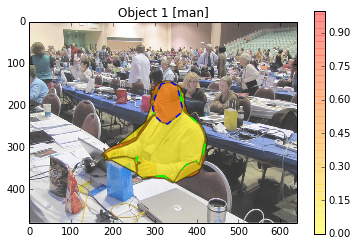

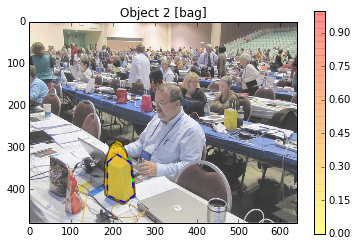

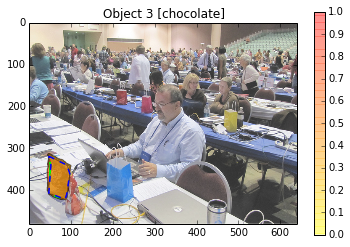

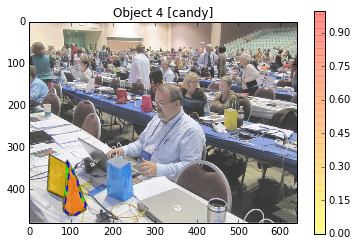

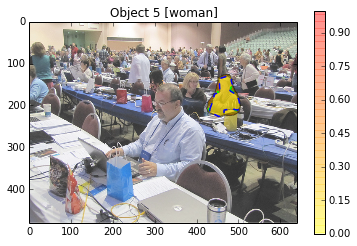

...

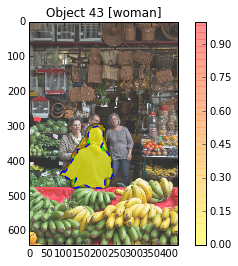

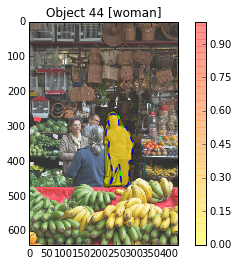

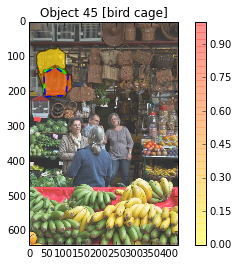

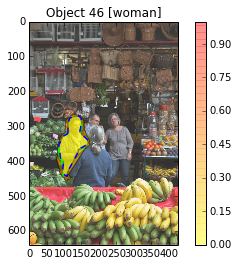

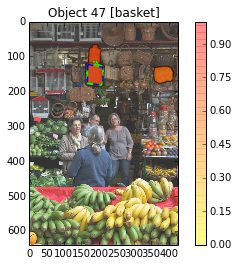

In [34]:
plot_all_obj_tiles(0,threshold=0.5)

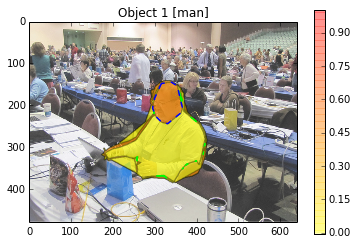

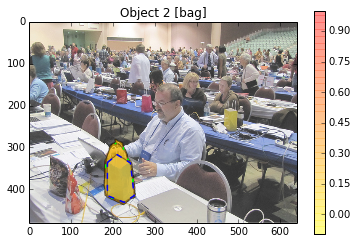

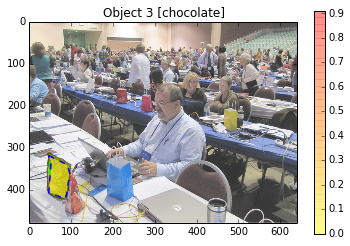

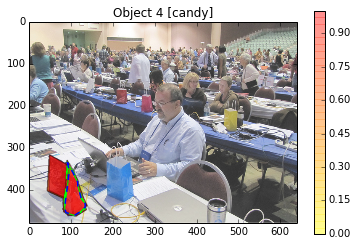

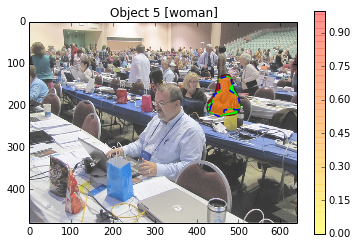

...

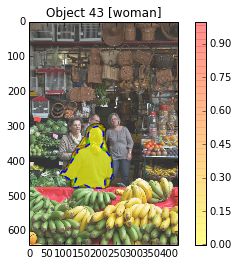

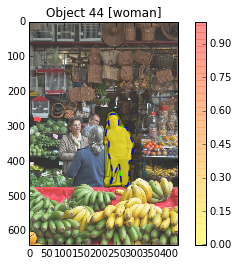

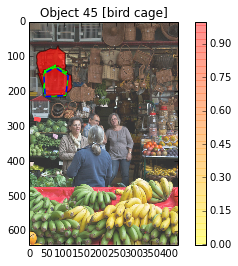

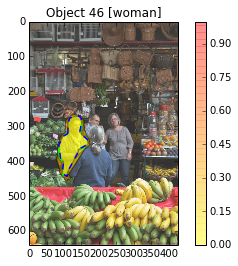

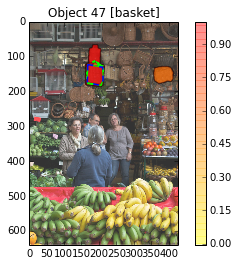

In [35]:
plot_all_obj_tiles(1,threshold=0.5)

ERROR:shapely.geos:TopologyException: Input geom 1 is invalid: Self-intersection at or near point 467.10000000000002 151.44069993519119 at 467.10000000000002 151.44069993519119


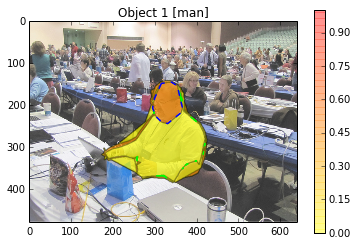

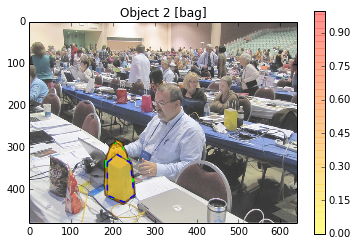

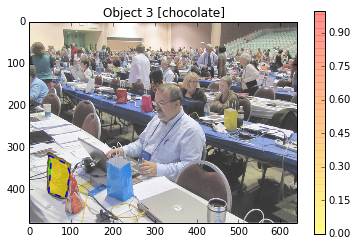

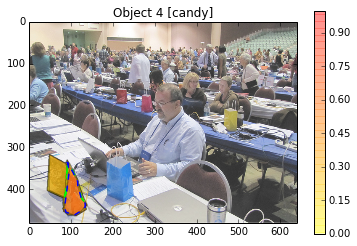

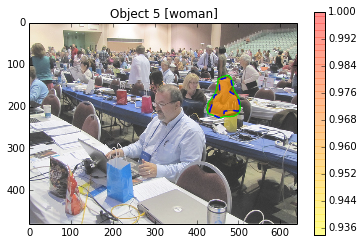

...

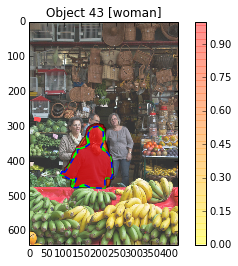

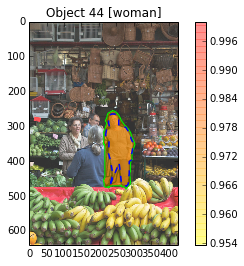

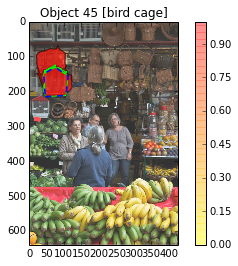

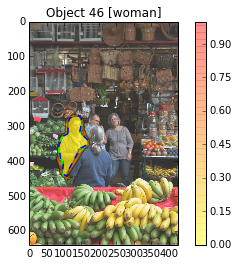

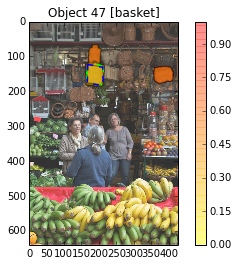

In [36]:
plot_all_obj_tiles(2,threshold=0.5)

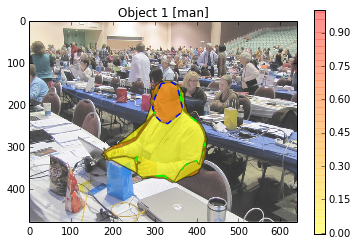

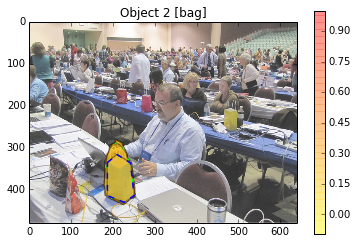

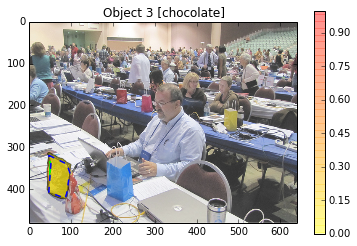

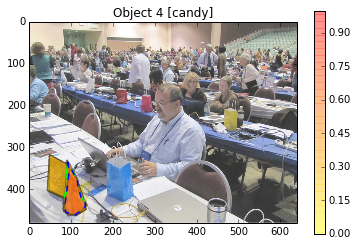

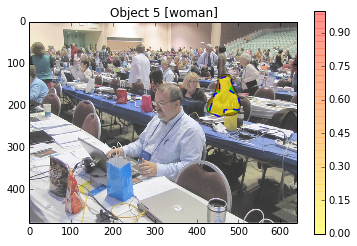

...

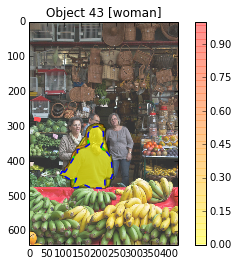

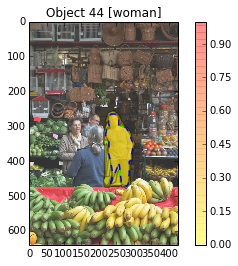

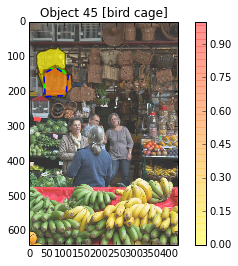

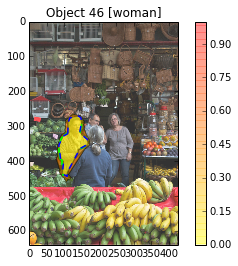

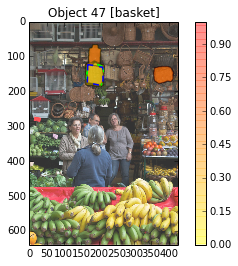

In [37]:
plot_all_obj_tiles(3,threshold=0.5)